In [25]:
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
import json
import imageio as io
from tqdm import tqdm


DATA_DIR = 'bpe-datasets/'

# MY FUNCTION to get stick video from sequences

In [2]:
def video_from_array_SARA(file, outpath, frames=30, frame_size=(640, 480)):
    if isinstance(file, str):
        # Load the numpy array
        motion_data = np.load(file)
        print('File loaded')
    else:
        motion_data = file

    # Normalize and scale the coordinates
    min_vals = np.min(motion_data, axis=(0, 2))
    max_vals = np.max(motion_data, axis=(0, 2))

    # Reshape min_vals for broadcasting
    min_vals_reshaped = min_vals.reshape((1, 3, 1))

    # Shift all values to be >= 0
    motion_data -= min_vals_reshaped

    # Find new max values and determine scale factor
    new_max_vals = np.max(motion_data, axis=(0, 2))
    scale_factors = frame_size / new_max_vals[:2]
    scale_factor = min(scale_factors) * 0.9  # Use the smaller scale and leave some margin

    # Apply scaling and center in the frame
    motion_data[:, :2, :] *= scale_factor
    offset = (frame_size - new_max_vals[:2] * scale_factor) / 2
    motion_data[:, 0, :] += offset[0]
    motion_data[:, 1, :] = frame_size[1] - (motion_data[:, 1, :] + offset[1])  # Invert y-axis

    # Define the pairs of keypoints for connecting corresponding body parts
    keypoint_pairs = [
        (0, 1),  # nose to left_eye
        (0, 2),  # nose to right_eye
        (1, 3),  # left_eye to left_ear
        (2, 4),  # right_eye to right_ear
        (5, 6),  # left_shoulder to right_shoulder
        (5, 7),  # left_shoulder to left_elbow
        (6, 8),  # right_shoulder to right_elbow
        (7, 9),  # left_elbow to left_wrist
        (8, 10), # right_elbow to right_wrist
        (5, 11), # left_shoulder to left_hip
        (6, 12), # right_shoulder to right_hip
        (11, 12),# left_hip to right_hip
        (11, 13),# left_hip to left_knee
        (12, 14),# right_hip to right_knee
        (13, 15),# left_knee to left_ankle
        (14, 16) # right_knee to right_ankle
    ]

    # Create a new MP4 video file with adjusted normalization
    fourcc_mp4 = cv2.VideoWriter_fourcc(*'mp4v')  # MP4 format
    out_mp4_scaled = cv2.VideoWriter(outpath, fourcc_mp4, frames, frame_size)

    # Create each frame of the video with scaled normalization
    for frame in range(motion_data.shape[2]):
        img = np.zeros((frame_size[1], frame_size[0], 3), dtype=np.uint8)  # Create a black image

        # Draw keypoints and lines
        for i in range(motion_data.shape[0]):
            x, y = motion_data[i, :2, frame]
            cv2.circle(img, (int(x), int(y)), 5, (0, 255, 0), -1)  # Draw keypoints

        # Draw lines connecting keypoints
        for start, end in keypoint_pairs:
            start_coords = (int(motion_data[start, 0, frame]), int(motion_data[start, 1, frame]))
            end_coords = (int(motion_data[end, 0, frame]), int(motion_data[end, 1, frame]))
            cv2.line(img, start_coords, end_coords, (255, 0, 0), 2)

        out_mp4_scaled.write(img)

    # Release the video writer
    out_mp4_scaled.release()


def frame_from_array_SARA(file, frame_num):
    if isinstance(file, str):
        motion_data = np.load(file)
    else:
        motion_data = file

    keypoints_array = motion_data[:, :2, frame_num]
    x, y = keypoints_array[:, 0], keypoints_array[:, 1]

    keypoints = [
        "nose",
        "left_eye",
        "right_eye",
        "left_ear",
        "right_ear",
        "left_shoulder",
        "right_shoulder",
        "left_elbow",
        "right_elbow",
        "left_wrist",
        "right_wrist",
        "left_hip",
        "right_hip",
        "left_knee",
        "right_knee",
        "left_ankle",
        "right_ankle"
    ]
    # Convert keypoints to dictionary for easy access
    keypoints_dict = {keypoint: coordinates for keypoint, coordinates in zip(keypoints, keypoints_array)}

    # Define the pairs of keypoints for connecting corresponding body parts
    keypoint_pairs = [
        ("nose", "left_eye"),
        ("nose", "right_eye"),
        ("left_eye", "left_ear"),
        ("right_eye", "right_ear"),
        ("left_shoulder", "right_shoulder"),
        ("left_shoulder", "left_elbow"),
        ("right_shoulder", "right_elbow"),
        ("left_elbow", "left_wrist"),
        ("right_elbow", "right_wrist"),
        ("left_shoulder", "left_hip"),
        ("right_shoulder", "right_hip"),
        ("left_hip", "right_hip"),
        ("left_hip", "left_knee"),
        ("right_hip", "right_knee"),
        ("left_knee", "left_ankle"),
        ("right_knee", "right_ankle")
    ]

    # Plotting the keypoints with connections
    plt.figure(figsize=(6, 8))
    plt.scatter(x, y, color='white')  # Plot keypoints

    # Draw lines between corresponding body parts
    for point1, point2 in keypoint_pairs:
        x_values = [keypoints_dict[point1][0], keypoints_dict[point2][0]]
        y_values = [keypoints_dict[point1][1], keypoints_dict[point2][1]]
        plt.plot(x_values, y_values, color='blue')

    plt.gca().set_facecolor('black')
    plt.title("Human Joints Keypoints with Connections")
    plt.xlabel("X Coordinate")
    plt.ylabel("Y Coordinate")
    plt.grid(True, color='gray')
    plt.show()

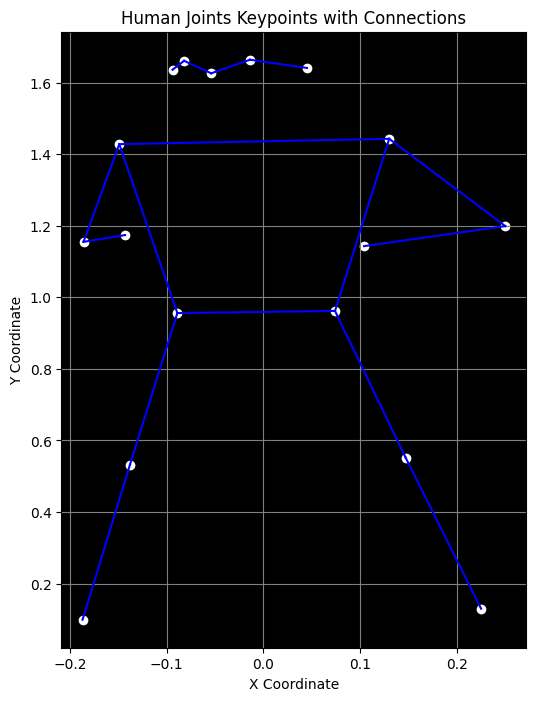

In [3]:
file = np.load(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motion.npy')

frame_from_array_SARA(file, 0)

In [4]:


video_from_array_SARA(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motion.npy', DATA_DIR + '/vid_from_SARA_arr/test_1.mp4')
video_from_array_SARA(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_-1|Activity_1/motion.npy', DATA_DIR + '/vid_from_SARA_arr/test_2.mp4')

File loaded
File loaded


In [5]:
f1 = np.load(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motions/1.npy')
f2 = np.load(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motions/2.npy')
f3 = np.load(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motions/3.npy')
f4 = np.load(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motions/4.npy')
f5 = np.load(DATA_DIR + 'SARA_released/train/FuseFemaleA/Adventure3/115/Height_1|Activity_0.5/motions/5.npy')

In [6]:
f1.shape, f2.shape, f3.shape, f4.shape, f5.shape

((17, 3, 32), (17, 3, 32), (17, 3, 32), (17, 3, 32), (17, 3, 32))

In [7]:
fixed = [f1, f2, f3, f4, f5]
for i in range(5):
    video_from_array_SARA(fixed[i], DATA_DIR + '/vid_from_SARA_arr/test_fixed_' + str(i) + '.mp4')

# inference_single_pair_visual.py

Just tryying to through file step by step to better understand it.
The similarity is working -- so if we input same pose seq to compare with same pose seq, we get similarity of one.

In [28]:
import argparse

from bpe.functional.motion import preprocess_motion2d_rc, cocopose2motion, json2annotations, annotations2motion

from bpe import Config

from bpe.similarity_analyzer import SimilarityAnalyzer

from bpe.functional.motion import preprocess_motion2d_rc, cocopose2motion

from bpe.functional.utils import pad_to_height

from bpe.functional.visualization import preprocess_sequence, video_out_with_imageio

data_dir = 'bpe-datasets/SARA_released'
model_path = 'train_log/exp_bpe/model/model_best.pth.tar'
video1 = 'S001C001P004R001A007_rgb.mp4'
video2 = 'S001C001P005R002A007_rgb.mp4'
v1 = 'bpe-datasets/refined_skeleton/007/S001C001P004R001A007.json'
v2 = 'bpe-datasets/refined_skeleton/007/S001C001P005R002A007.json'
img1_height = 1080
img1_width = 1920
img2_height = 1080
img2_width = 1920
pad2 = 0

parser = argparse.ArgumentParser()
parser.add_argument('--name', type=str, default="sim_test", help="task name")
parser.add_argument('--data_dir', default="", required=True, help="path to dataset dir")
parser.add_argument('--model_path', type=str, required=True, help="filepath for trained model weights")
parser.add_argument('--video1', type=str, required=True, help="video1 mp4 path", default=None)
parser.add_argument('--video2', type=str, required=True, help="video2 mp4 path", default=None)
parser.add_argument('-v1', '--vid1_json_dir', type=str, required=True, help="video1's coco annotation json")
parser.add_argument('-v2', '--vid2_json_dir', type=str, required=True, help="video2's coco annotation json")
parser.add_argument('-h1', '--img1_height', type=int, help="video1's height", default=480)
parser.add_argument('-w1', '--img1_width', type=int, help="video1's width", default=854)
parser.add_argument('-h2', '--img2_height', type=int, help="video2's height", default=480)
parser.add_argument('-w2', '--img2_width', type=int, help="video2's width", default=854)
parser.add_argument('-pad2', '--pad2', type=int, help="video2's start frame padding", default=0)
parser.add_argument('-g', '--gpu_ids', type=int, default=0, required=False)
parser.add_argument('--out_path', type=str, default='./visual_results', required=False)
parser.add_argument('--out_filename', type=str, default='twice.mp4', required=False)
parser.add_argument('--use_flipped_motion', action='store_true',
                    help="whether to use one decoder per one body part")
parser.add_argument('--use_invisibility_aug', action='store_true',
                    help="change random joints' visibility to invisible during training")
parser.add_argument('--debug', action='store_true', help="limit to 500 frames")
# related to video processing
parser.add_argument('--video_sampling_window_size', type=int, default=16,
                    help='window size to use for similarity prediction')
parser.add_argument('--video_sampling_stride', type=int, default=16,
                    help='stride determining when to start next window of frames')
parser.add_argument('--use_all_joints_on_each_bp', action='store_true',
                    help="using all joints on each body part as input, as opposed to particular body part")

parser.add_argument('--similarity_measurement_window_size', type=int, default=1,
                    help='measuring similarity over # of oversampled video sequences')
parser.add_argument('--similarity_distance_metric', choices=["cosine", "l2"], default="cosine")
parser.add_argument('--privacy_on', action='store_true',
                    help='when on, no original video or sound in present in the output video')
parser.add_argument('--thresh', type=float, default=0.5, help='threshold to seprate positive and negative classes')
parser.add_argument('--connected_joints', action='store_true', help='connect joints with lines in the output video')


args = parser.parse_args([
    '--data_dir', data_dir, 
    '--model_path', model_path,
    '--video1', video1,
    '--video2', video2,
    '-v1', v1,
    '-v2', v2,
    '--img1_height', str(img1_height),
    '--img1_width', str(img1_width),
    '--img2_height', str(img2_height),
    '--img2_width', str(img2_width),
    '--pad2', str(pad2)
    ])

In [29]:
mean_pose_bpe = np.load(os.path.join(data_dir, 'meanpose_rc_with_view_unit64.npy'))
std_pose_bpe = np.load(os.path.join(data_dir, 'stdpose_rc_with_view_unit64.npy'))
mean_pose_bpe.shape, std_pose_bpe.shape

((19, 2), (19, 2))

In [30]:
if not os.path.exists(args.out_path):
        os.makedirs(args.out_path)

config = Config(args)
similarity_analyzer = SimilarityAnalyzer(config, args.model_path)

Building model
Loading model from train_log/exp_bpe/model/model_best.pth.tar
Model is ready


In [31]:
# for NTU-RGB test - it used w:1920, h:1080
h1, w1, scale1 = pad_to_height(config.img_size[0], args.img1_height, args.img1_width)
h2, w2, scale2 = pad_to_height(config.img_size[0], args.img2_height, args.img2_width)
h1, w1, scale1, h2, w2, scale2

(512, 912, 0.4740740740740741, 512, 912, 0.4740740740740741)

In [32]:
# get input suitable for motion similarity analyzer
seq1 = cocopose2motion(config.unique_nr_joints, args.vid1_json_dir, scale=scale1,
                        visibility=args.use_invisibility_aug)
seq2 = cocopose2motion(config.unique_nr_joints, args.vid2_json_dir, scale=scale2,
                        visibility=args.use_invisibility_aug)[:, :, args.pad2:]
seq1.shape, seq2.shape

((15, 2, 74), (15, 2, 55))

In [33]:
seq1 = preprocess_sequence(seq1)
seq2 = preprocess_sequence(seq2)

seq1_origin = preprocess_motion2d_rc(seq1, mean_pose_bpe, std_pose_bpe,
                                        invisibility_augmentation=args.use_invisibility_aug,
                                        use_all_joints_on_each_bp=args.use_all_joints_on_each_bp)
seq2_origin = preprocess_motion2d_rc(seq2, mean_pose_bpe, std_pose_bpe,
                                        invisibility_augmentation=args.use_invisibility_aug,
                                        use_all_joints_on_each_bp=args.use_all_joints_on_each_bp)

seq1.shape, seq2.shape, seq1_origin.shape, seq2_origin.shape

((15, 2, 74), (15, 2, 55), torch.Size([1, 38, 74]), torch.Size([1, 38, 55]))

In [34]:
seq1_origin = seq1_origin.to(config.device)
seq2_origin = seq2_origin.to(config.device)

In [35]:
# get embeddings
seq1_features = similarity_analyzer.get_embeddings(seq1_origin, video_window_size=args.video_sampling_window_size,
                                                       video_stride=args.video_sampling_stride)
seq2_features = similarity_analyzer.get_embeddings(seq2_origin, video_window_size=args.video_sampling_window_size,
                                                       video_stride=args.video_sampling_stride)

In [36]:
# get motion similarity
motion_similarity_per_window = \
    similarity_analyzer.get_similarity_score(seq1_features, seq2_features,
                                                similarity_window_size=args.similarity_measurement_window_size)

motion_similarity_per_window

[{'ra': 0.7972625494003296,
  'la': 0.38294732570648193,
  'rl': 0.9974727630615234,
  'll': 0.9870721697807312,
  'torso': 0.9960094094276428},
 {'ra': 0.3218836784362793,
  'la': -0.15505418181419373,
  'rl': 0.987751305103302,
  'll': 0.9888168573379517,
  'torso': 0.9905686378479004},
 {'ra': 0.6710232496261597,
  'la': 0.9687018990516663,
  'rl': 0.99736088514328,
  'll': 0.9915494918823242,
  'torso': 0.9439309239387512}]

In [37]:
# suppose same video horizontal
video_width = int(config.img_size[0] / args.img1_height * args.img1_width + config.img_size[0] / args.img2_height * args.img2_width)
video_height = config.img_size[0]

video_width, video_height

(1820, 512)

In [38]:
# video_out_with_imageio(output_path=os.path.join(args.out_path, args.out_filename),
#                            width=video_width, height=video_height,
#                            sequence1=seq1.transpose(2, 0, 1), sequence2=seq2.transpose(2, 0, 1),
#                            video1_path=args.video1, video2_path=args.video2,
#                            left_padding=int(config.img_size[0] / args.img1_height * args.img1_width),
#                            pad2=args.pad2,
#                            motion_similarity_per_window=motion_similarity_per_window, is_debug=args.debug,
#                            thresh=args.thresh,
#                            privacy_on=args.privacy_on, is_connected_joints=args.connected_joints)

## video_out_with_imageio

In [102]:
output_path=os.path.join(args.out_path, args.out_filename)
width=video_width
height=video_height
sequence1=seq1.transpose(2, 0, 1)
sequence2=seq2.transpose(2, 0, 1)
video1_path=args.video1
video2_path=args.video2
left_padding=int(config.img_size[0] / args.img1_height * args.img1_width)
pad2=args.pad2
motion_similarity_per_window=motion_similarity_per_window
is_debug=args.debug,
thresh=args.thresh
privacy_on=args.privacy_on
is_connected_joints=args.connected_jointsoutput_path=os.path.join(args.out_path, args.out_filename)

In [103]:
output_path

'./visual_results/twice.mp4'

In [104]:
assert sequence1.shape[1:] == (15, 2)
assert sequence2.shape[1:] == (15, 2)

# get video readers
video1 = io.get_reader(video1_path)
video2 = io.get_reader(video2_path)

# get output video writer
out_video_writer = io.get_writer(output_path, mode='I', fps=video1.get_meta_data()['fps'])

# align videos
video1 = iter(video1)
video2 = iter(video2)
for i in range(pad2):
    next(video2)

total_vid_length = min(len(sequence1), len(sequence2))

In [105]:
import math
from subprocess import Popen
from typing import Iterable

import cv2
import numpy as np
from tqdm import tqdm
import imageio as io


def get_video_from_sequence(seq, height, width):
    num_frames = seq.shape[-1]
    channel = 3
    color = [int(i) for i in np.random.randint(0, 255, size=channel)]
    video = np.zeros((num_frames, height, width, channel))
    for frame_idx in range(num_frames):
        cur_img = np.zeros((height, width, len(color)))
        for joint_idx in range(seq.shape[0]):
            x_coord, y_coord = seq[joint_idx, :, frame_idx]
            cv2.circle(cur_img, (int(x_coord), int(y_coord)), 1, color, 2)
        video[frame_idx] = cur_img
    return video


def get_colors_per_joint(motion_similarity_per_window, percentage_processed, thresh):
    color_per_joint = np.tile([0, 255, 0], (15, 1))

    temporal_idx = math.floor(percentage_processed * len(motion_similarity_per_window))
    if temporal_idx >= len(motion_similarity_per_window):
        return color_per_joint
    '''
    joints order : 
    [nose, neck,
    right_shoulder, right_elbow, right_wrist,
    left_shoulder, left_elbow, left_wrist,
    mid_hip,
    right_hip, right_knee, right_ankle,
    left_hip, left_knee, left_ankle]
    '''
    for bp_idx, bp in enumerate(motion_similarity_per_window[temporal_idx].keys()):
        similarity = round(motion_similarity_per_window[temporal_idx][bp], 2)
        cur_joint_color = (0, 255, 0) if similarity > thresh else (255, 0, 0)
        if bp == 'torso':
            color_per_joint[[0, 1, 8]] = cur_joint_color
        elif bp == 'ra':
            color_per_joint[[2, 3, 4]] = cur_joint_color
        elif bp == 'la':
            color_per_joint[[5, 6, 7]] = cur_joint_color
        elif bp == 'rl':
            color_per_joint[[9, 10, 11]] = cur_joint_color
        elif bp == 'll':
            color_per_joint[[12, 13, 14]] = cur_joint_color
        else:
            raise KeyError('Wrong body part key')
    return color_per_joint


def put_similarity_score_in_video(img, motion_similarity_per_window, percentage_processed, thresh):
    temporal_idx = math.floor(percentage_processed * len(motion_similarity_per_window))
    if temporal_idx >= len(motion_similarity_per_window):
        return

    similarity_per_bp = motion_similarity_per_window[temporal_idx]
    for bp_idx, bp in enumerate(similarity_per_bp.keys()):
        similarity = round(similarity_per_bp[bp], 2)
        color = (0, 255, 0) if similarity > thresh else (255, 0, 0)
        y_coord, x_coord = 50 + 50 * bp_idx, 0
        cv2.putText(img, '{}:{}'.format(bp, similarity), (x_coord, y_coord), cv2.FONT_HERSHEY_SIMPLEX, 1,
                    color, 2)

    # setting for paper
    # for bp_idx, bp in enumerate(similarity_per_bp.keys()):
    #    similarity = round(similarity_per_bp[bp], 2)
    #    color = (0, 255, 0) if similarity > thresh else (255, 0, 0)
    #    y_coord, x_coord = 25, 2 + 70 * bp_idx
    #    cv2.putText(img, '{}:{}'.format(bp, similarity), (x_coord, y_coord), cv2.FONT_HERSHEY_SIMPLEX, 0.4,
    #                color, 1)


def preprocess_sequence(seq):
    for idx, seq_item in enumerate(seq):
        if len(seq_item) == 0:
            seq[idx] = seq[idx - 1]
        if idx > 0:
            seq_item[np.where(seq_item == 0)] = seq[idx - 1][np.where(seq_item == 0)]

    return seq


def draw_seq(img, frame_seq, color_per_joint, left_padding=0, is_connected_joints=False):
    assert len(frame_seq) == len(color_per_joint)

    if is_connected_joints:
        draw_connected_joints(img, frame_seq, color_per_joint, left_padding)

    # add joints visualization
    stickwidth = 3
    # stickwidth = 1  # setting for paper
    for joint_idx, joint_xy in enumerate(frame_seq):
        x_coord, y_coord = joint_xy

        # setting for the paper
        # x_coord = x_coord // 5
        # y_coord = y_coord // 2

        color = [int(i) for i in color_per_joint[joint_idx]]
        cv2.circle(img, (left_padding + int(x_coord), int(y_coord)), stickwidth, color, 3)


def draw_connected_joints(canvas, joints, colors, left_padding):
    # connect joints with lines
    # ([nose, neck,
    # right_shoulder, right_elbow, right_wrist,
    # left_shoulder, left_elbow, left_wrist,
    # mid_hip,
    # right_hip, right_knee, right_ankle,
    # left_hip, left_knee, left_ankle,])

    limb_seq = [[0, 1], [1, 8], [2, 3], [3, 4], [5, 6], [6, 7], [9, 10], [10, 11], [12, 13], [13, 14]]

    stickwidth = 2
    # stickwidth = 1 # setting for paper
    for i in range(len(limb_seq)):
        X = (int(joints[limb_seq[i][0]][0] + left_padding), int(joints[limb_seq[i][1]][0] + left_padding))
        Y = (int(joints[limb_seq[i][0]][1]), int(joints[limb_seq[i][1]][1]))

        # setting for the paper
        # X = (int(joints[limb_seq[i][0]][0] // 5 + left_padding), int(joints[limb_seq[i][1]][0] // 5 + left_padding))
        # Y = (int(joints[limb_seq[i][0]][1] // 2), int(joints[limb_seq[i][1]][1]) // 2)

        mX = np.mean(X)
        mY = np.mean(Y)
        length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
        angle = math.degrees(math.atan2(Y[0] - Y[1], X[0] - X[1]))
        polygon = cv2.ellipse2Poly((int(mX), int(mY)), (int(length / 2), stickwidth), int(angle), 0, 360, 1)
        color = [int(i) for i in colors[limb_seq[i][0]]]
        cv2.fillConvexPoly(canvas, polygon, color)

    return canvas


def draw_frame(img, video_frame, left_padding=0, left_position=True, privacy_on=False):
    if privacy_on:
        video_frame = np.ones_like(video_frame) * 255

    left_padding, left_end = (0, left_padding) if left_position else (left_padding, img.shape[1])

    resized_video_frame = cv2.resize(video_frame, dsize=(left_end - left_padding, img.shape[0]),
                                     interpolation=cv2.INTER_CUBIC)
    img[:, left_padding:left_end, :] = resized_video_frame[:]


def video_out(output_stream: Popen, width: int, height: int,
              sequence1: np.ndarray, sequence2: np.ndarray,
              video1: Iterable[np.ndarray], video2: Iterable[np.ndarray], left_padding: int,
              motion_similarity_per_window: list,
              is_debug: bool, thresh: float, privacy_on=False, is_connected_joints=False):
    """
    visualization of the input sequences
    :param output_stream: ffmpeg stream. rawimage stream needed
    :param width:
    :param height:
    :param sequence1: shape (#frames, #joints, #coords(e.g. x,y)
    :param sequence2: shape (N, 15, 2)
    :param video1:
    :param video2:
    :param motion_similarity_per_window:
    :return:
    """
    assert sequence1.shape[1:] == (15, 2)
    assert sequence2.shape[1:] == (15, 2)

    total_vid_length = min(len(sequence1), len(sequence2))

    for frame_idx, frame_seq1, frame_seq2 in tqdm(zip(range(total_vid_length), sequence1, sequence2),
                                                  total=total_vid_length, desc='Output video saving progress'):

        canvas = np.ones((height, width, 3), np.uint8) * 255

        if video1 is not None:
            draw_frame(canvas, next(video1), left_padding=left_padding, left_position=True, privacy_on=privacy_on)
        if video2 is not None:
            draw_frame(canvas, next(video2), left_padding=left_padding, left_position=False, privacy_on=privacy_on)

        percentage_processed = float(frame_idx) / total_vid_length
        # get colors for each joint to visialize which body parts disagree
        color_per_joint = get_colors_per_joint(motion_similarity_per_window, percentage_processed, thresh)
        if frame_seq1 is not None:
            draw_seq(canvas, frame_seq1, color_per_joint, left_padding=0, is_connected_joints=is_connected_joints)
        if frame_seq2 is not None:
            draw_seq(canvas, frame_seq2, color_per_joint, left_padding=left_padding, is_connected_joints=is_connected_joints)

        put_similarity_score_in_video(canvas, motion_similarity_per_window, percentage_processed, thresh)

        output_stream.stdin.write(canvas.tostring())
        if is_debug and frame_idx == 1000:
            break
    output_stream.stdin.close()
    output_stream.wait()


def video_out_with_imageio(output_path: str, width: int, height: int,
                           sequence1: np.ndarray, sequence2: np.ndarray,
                           video1_path: str, video2_path: str, left_padding: int, pad2: int,
                           motion_similarity_per_window: list,
                           is_debug: bool, thresh: float, privacy_on=False, is_connected_joints=False):
    """
    visualization of the input sequences
    :param output_path: output path to save the file
    :param width:
    :param height:
    :param sequence1: shape (#frames, #joints, #coords(e.g. x,y)
    :param sequence2: shape (N, 15, 2)
    :param video1:
    :param video2:
    :param motion_similarity_per_window:
    :return:
    """
    assert sequence1.shape[1:] == (15, 2)
    assert sequence2.shape[1:] == (15, 2)

    # get video readers
    video1 = io.get_reader(video1_path)
    video2 = io.get_reader(video2_path)

    # get output video writer
    out_video_writer = io.get_writer(output_path, mode='I', fps=video1.get_meta_data()['fps'])

    # align videos
    video1 = iter(video1)
    video2 = iter(video2)
    for i in range(pad2):
        next(video2)

    total_vid_length = min(len(sequence1), len(sequence2))

    for frame_idx, frame_seq1, frame_seq2 in tqdm(zip(range(total_vid_length), sequence1, sequence2),
                                                  total=total_vid_length, desc='Output video saving progress'):

        canvas = np.ones((height, width, 3), np.uint8) * 255

        if video1 is not None:
            draw_frame(canvas, next(video1), left_padding=left_padding, left_position=True, privacy_on=privacy_on)
        if video2 is not None:
            draw_frame(canvas, next(video2), left_padding=left_padding, left_position=False, privacy_on=privacy_on)

        percentage_processed = float(frame_idx) / total_vid_length
        # get colors for each joint to visialize which body parts disagree
        color_per_joint = get_colors_per_joint(motion_similarity_per_window, percentage_processed, thresh)
        if frame_seq1 is not None:
            # draw_seq(canvas, frame_seq1, color_per_joint, left_padding=left_padding, left_position=True,
            #          is_connected_joints=is_connected_joints)
            draw_seq(canvas, frame_seq1, color_per_joint, left_padding=left_padding,
                     is_connected_joints=is_connected_joints)
        if frame_seq2 is not None:
            # draw_seq(canvas, frame_seq2, color_per_joint, left_padding=left_padding, left_position=False,
            #          is_connected_joints=is_connected_joints)
            draw_seq(canvas, frame_seq2, color_per_joint, left_padding=left_padding,
                     is_connected_joints=is_connected_joints)

        put_similarity_score_in_video(canvas, motion_similarity_per_window, percentage_processed, thresh)

        if is_debug and frame_idx == 500:
            break

        out_video_writer.append_data(canvas.tobytes())

    out_video_writer.close()


In [106]:
all_frames = []

for frame_idx, frame_seq1, frame_seq2 in tqdm(zip(range(total_vid_length), sequence1, sequence2),
                                                  total=total_vid_length, desc='Output video saving progress'):

        canvas = np.ones((height, width, 3), np.uint8) * 255

        if video1 is not None:
            draw_frame(canvas, next(video1), left_padding=left_padding, left_position=True, privacy_on=privacy_on)
        if video2 is not None:
            draw_frame(canvas, next(video2), left_padding=left_padding, left_position=False, privacy_on=privacy_on)

        percentage_processed = float(frame_idx) / total_vid_length
        # get colors for each joint to visialize which body parts disagree
        color_per_joint = get_colors_per_joint(motion_similarity_per_window, percentage_processed, thresh)
        if frame_seq1 is not None:
            # draw_seq(canvas, frame_seq1, color_per_joint, left_padding=left_padding, left_position=True,
            #          is_connected_joints=is_connected_joints)
            draw_seq(canvas, frame_seq1, color_per_joint, left_padding=0,
                     is_connected_joints=is_connected_joints)
        if frame_seq2 is not None:
            # draw_seq(canvas, frame_seq2, color_per_joint, left_padding=left_padding, left_position=False,
            #          is_connected_joints=is_connected_joints)
            draw_seq(canvas, frame_seq2, color_per_joint, left_padding=left_padding,
                     is_connected_joints=is_connected_joints)

        put_similarity_score_in_video(canvas, motion_similarity_per_window, percentage_processed, thresh)

        if is_debug and frame_idx == 500:
            break

        # out_video_writer.append_data(im=canvas)
        all_frames.append(canvas)

Output video saving progress: 100%|██████████| 55/55 [00:00<00:00, 99.52it/s] 


In [108]:
io.mimwrite('test.mp4', all_frames, fps=30)

In [62]:
import math
def draw_seq(img, frame_seq, color_per_joint, left_padding=0, is_connected_joints=False):
    assert len(frame_seq) == len(color_per_joint)

    if is_connected_joints:
        draw_connected_joints(img, frame_seq, color_per_joint, left_padding)

    # add joints visualization
    stickwidth = 3
    # stickwidth = 1  # setting for paper
    for joint_idx, joint_xy in enumerate(frame_seq):
        x_coord, y_coord = joint_xy

        # setting for the paper
        # x_coord = x_coord // 5
        # y_coord = y_coord // 2

        color = [int(i) for i in color_per_joint[joint_idx]]
        cv2.circle(img, (left_padding + int(x_coord), int(y_coord)), stickwidth, color, 3)



def get_colors_per_joint(motion_similarity_per_window, percentage_processed, thresh):
    color_per_joint = np.tile([0, 255, 0], (15, 1))

    temporal_idx = math.floor(percentage_processed * len(motion_similarity_per_window))
    if temporal_idx >= len(motion_similarity_per_window):
        return color_per_joint
    '''
    joints order : 
    [nose, neck,
    right_shoulder, right_elbow, right_wrist,
    left_shoulder, left_elbow, left_wrist,
    mid_hip,
    right_hip, right_knee, right_ankle,
    left_hip, left_knee, left_ankle]
    '''
    for bp_idx, bp in enumerate(motion_similarity_per_window[temporal_idx].keys()):
        similarity = round(motion_similarity_per_window[temporal_idx][bp], 2)
        cur_joint_color = (0, 255, 0) if similarity > thresh else (255, 0, 0)
        if bp == 'torso':
            color_per_joint[[0, 1, 8]] = cur_joint_color
        elif bp == 'ra':
            color_per_joint[[2, 3, 4]] = cur_joint_color
        elif bp == 'la':
            color_per_joint[[5, 6, 7]] = cur_joint_color
        elif bp == 'rl':
            color_per_joint[[9, 10, 11]] = cur_joint_color
        elif bp == 'll':
            color_per_joint[[12, 13, 14]] = cur_joint_color
        else:
            raise KeyError('Wrong body part key')
    return color_per_joint

def draw_connected_joints(canvas, joints, colors, left_padding):
    # connect joints with lines
    # ([nose, neck,
    # right_shoulder, right_elbow, right_wrist,
    # left_shoulder, left_elbow, left_wrist,
    # mid_hip,
    # right_hip, right_knee, right_ankle,
    # left_hip, left_knee, left_ankle,])

    limb_seq = [[0, 1], [1, 8], [2, 3], [3, 4], [5, 6], [6, 7], [9, 10], [10, 11], [12, 13], [13, 14]]

    stickwidth = 2
    # stickwidth = 1 # setting for paper
    for i in range(len(limb_seq)):
        X = (int(joints[limb_seq[i][0]][0] + left_padding), int(joints[limb_seq[i][1]][0] + left_padding))
        Y = (int(joints[limb_seq[i][0]][1]), int(joints[limb_seq[i][1]][1]))

        # setting for the paper
        # X = (int(joints[limb_seq[i][0]][0] // 5 + left_padding), int(joints[limb_seq[i][1]][0] // 5 + left_padding))
        # Y = (int(joints[limb_seq[i][0]][1] // 2), int(joints[limb_seq[i][1]][1]) // 2)

        mX = np.mean(X)
        mY = np.mean(Y)
        length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
        angle = math.degrees(math.atan2(Y[0] - Y[1], X[0] - X[1]))
        polygon = cv2.ellipse2Poly((int(mX), int(mY)), (int(length / 2), stickwidth), int(angle), 0, 360, 1)
        color = [int(i) for i in colors[limb_seq[i][0]]]
        cv2.fillConvexPoly(canvas, polygon, color)

    return canvas


# Json files exploring

In [35]:
from bpe.functional.motion import *
from bpe.functional.visualization import *

In [28]:
annot = json2annotations('bpe-datasets/refined_skeleton/007/S001C001P004R001A007.json')

In [29]:
keypoint = annot[0]['objects'][0]['keypoints']
coco = np.array(keypoint).reshape(-1, 3)
coco = coco[:, :2]
nose = coco[0]
right_shoulder = coco[6]
right_elbow = coco[8]
right_wrist = coco[10]
left_shoulder = coco[5]
left_elbow = coco[7]
left_wrist = coco[9]
right_hip = coco[12]
right_knee = coco[14]
right_ankle = coco[16]
left_hip = coco[11]
left_knee = coco[13]
left_ankle = coco[15]
neck = (right_shoulder + left_shoulder) / 2
mid_hip = (right_hip + left_hip) / 2

joint = np.array([nose,
                          neck,
                          right_shoulder,
                          right_elbow,
                          right_wrist,
                          left_shoulder,
                          left_elbow,
                          left_wrist,
                          mid_hip,
                          right_hip,
                          right_knee,
                          right_ankle,
                          left_hip,
                          left_knee,
                          left_ankle,
                          ])

In [30]:
joint

array([[1059.01 ,  289.09 ],
       [1083.765,  346.84 ],
       [1042.51 ,  344.09 ],
       [1037.01 ,  404.6  ],
       [1015.01 ,  426.6  ],
       [1125.02 ,  349.59 ],
       [1147.02 ,  432.1  ],
       [1081.02 ,  443.1  ],
       [1070.015,  489.86 ],
       [1048.01 ,  487.11 ],
       [1053.51 ,  602.62 ],
       [1064.51 ,  696.13 ],
       [1092.02 ,  492.61 ],
       [1097.52 ,  602.62 ],
       [1097.52 ,  707.13 ]])

In [118]:
def reshape_to_3d(motion_sequence):
    """Reshapes a 2D motion sequence to 3D by adding a zero z-coordinate."""
    return np.concatenate((motion_sequence, np.zeros((motion_sequence.shape[0], 1, motion_sequence.shape[2]))), axis=1)

In [34]:
# seq = reshape_to_3d(annotations2motion(15, annot))
seq1 = cocopose2motion(15, 'bpe-datasets/refined_skeleton/007/S001C001P004R001A007.json')
seq1[:, :, 0], seq1.shape

(array([[1057.58221139,  289.98431819],
        [1082.99899123,  347.73014975],
        [1042.6938119 ,  344.04411505],
        [1036.6642351 ,  405.09539794],
        [1015.63066554,  428.98056245],
        [1123.30417056,  351.41618444],
        [1146.50219535,  432.01233208],
        [1081.23964239,  445.46935431],
        [1068.58024243,  491.60665146],
        [1046.58832216,  488.85807682],
        [1053.15631405,  604.30743995],
        [1064.88408187,  698.31525106],
        [1090.5721627 ,  494.35522609],
        [1096.0708498 ,  604.30743995],
        [1097.72976285,  709.30685496]]),
 (15, 2, 74))

In [26]:
canvas = np.ones((1080, 1920, 3), np.uint8) * 255
canvas.tobytes()

b'\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x

In [37]:
draw_connected_joints(canvas, seq1, color=(0, 0, 255), thickness=2)

TypeError: draw_connected_joints() got an unexpected keyword argument 'color'